<p><span style="font-size: 18pt;"><strong>Cartography with Python + Geopandas</strong></span></p>

<p><span style="font-size: 12pt;">This is an introduction of how we can use the geopandas to create meaningful <a href="https://en.wikipedia.org/wiki/Cartography" target="_blank" rel="nofollow noopener">cartography</a> graphics.</span></p>
<p><span style="font-size: 12pt;">Also I will try to use different type of classification methods to view heatmaps of Turkey's population as per counties.<br /><br />Before starting, install all dependencies as per your missing configuration.<br /></span><span style="font-size: 12pt;"><br />I used population of Turkey's dataset from site&nbsp;<a href="https://data.tuik.gov.tr/Turcat" target="_blank" rel="nofollow noopener">TUİK</a></span></p>
<p>You can use your own set.</p>

In [219]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from geopandas import GeoSeries, GeoDataFrame
#import geoplot
from tabulate import tabulate
import random

In [220]:
# set the filepath and load
fp = "shapes/tur_polbna_adm2.shp" #there are some bugs - I tried to fix as possible - be sure about the indexes are matching
#reading the shape file
map_df = gpd.read_file(fp)

map_df.head()

,OBJECTID,adm2_tr,adm2_en,adm1_tr,adm1_en,adm1,pcode,Shape_Leng,Shape_Area,geometry
0,1,ŞİŞLİ,SISLI,İSTANBUL,ISTANBUL,TUR034,TUR034035,0.187408,0.001147,"POLYGON ((29.00802 41.08488, 29.00928 41.08346..."
1,2,ÇİĞLİ,CIGLI,İZMİR,IZMIR,TUR035,TUR035010,1.138818,0.014430,"POLYGON ((27.06797 38.46423, 27.06785 38.46418..."
2,3,ŞİLE,SILE,İSTANBUL,ISTANBUL,TUR034,TUR034034,1.862735,0.085721,"POLYGON ((29.84881 41.01343, 29.84697 41.01245..."
3,4,ŞİRAN,SIRAN,GÜMÜŞHANE,GUMUSHANE,TUR029,TUR029005,1.425890,0.102039,"POLYGON ((39.32492 40.29221, 39.32482 40.29085..."
4,5,ŞİRVAN,SIRVAN,SİİRT,SIIRT,TUR056,TUR056006,1.372220,0.096102,"POLYGON ((41.95335 38.00632, 41.95321 38.00755..."


<p>Lets see the all map!</p>

<AxesSubplot:>

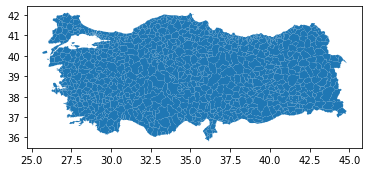

In [221]:
#plotting the map control 
map_df.plot()

In [222]:
#upload data and merge with geodataframe
df = pd.read_excel('population.xlsx')
df.head()

#index matching column and the data column
df = df[['CountyName','PopulationTotal']]

#renaming the column name
data_for_map = df.rename(index=str, columns={'PopulationTotal': 'POP'})


In [223]:
# dataframe
data_for_map.head()

,CountyName,POP
0,DERECİK,22988
1,SULTANHANI,11374
2,ALADAĞ,15896
3,CEYHAN,160616
4,ÇUKUROVA,364118


In [224]:
# joining the geodataframe with the cleaned up csv dataframe
merged = map_df.set_index('adm2_tr').join(data_for_map.set_index('CountyName'))
merged.head()

,OBJECTID,adm2_en,adm1_tr,adm1_en,adm1,pcode,Shape_Leng,Shape_Area,geometry,POP
19 MAYIS,57,19 MAYIS,SAMSUN,SAMSUN,TUR055,TUR055001,0.923862,0.025508,"POLYGON ((36.11499 41.63052, 36.11872 41.62225...",24982
ABANA,65,ABANA,KASTAMONU,KASTAMONU,TUR037,TUR037001,0.342281,0.003105,"POLYGON ((33.99871 41.98059, 34.00053 41.98096...",3931
ACIGÖL,66,ACIGOL,NEVŞEHİR,NEVSEHIR,TUR050,TUR050001,1.091920,0.047064,"POLYGON ((34.50167 38.34965, 34.49758 38.35188...",19121
ACIPAYAM,67,ACIPAYAM,DENİZLİ,DENIZLI,TUR020,TUR020001,2.389140,0.180070,"POLYGON ((29.42514 37.65268, 29.42583 37.65263...",55384
ADAKLI,69,ADAKLI,BİNGÖL,BINGOL,TUR012,TUR012001,1.304050,0.086816,"POLYGON ((40.46354 39.39548, 40.46494 39.39523...",8221


<p><span style="font-size: 12pt;"><strong>Time to Map!</strong></span></p>
<p><span style="font-size: 12pt;">We are goint to use Jenks natural breaks optimization as the main classification method for a more meaningful visualization of map. <br />Ref:&nbsp;<a href="https://en.wikipedia.org/wiki/Jenks_natural_breaks_optimization" target="_blank">Jenks natural breaks optimization</a></span></p>

<AxesSubplot:>

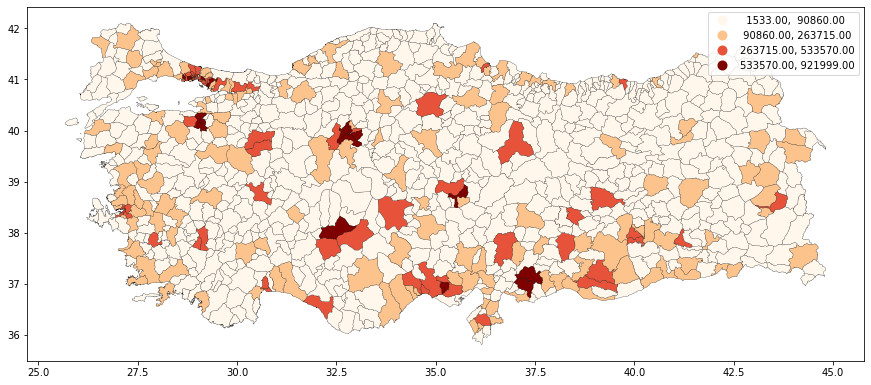

In [225]:
variable = 'POP' #the main column for the data comparision
# set the range for the choropleth
vmin, vmax = 100, 150
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(15, 9))

merged.plot(column=variable, cmap='BuGn', linewidth=0.2, ax=ax, edgecolor='0.6')
merged.plot(column=variable, scheme='natural_breaks', linewidth=0.2, k=4, cmap='OrRd', ax=ax, edgecolor='k', legend=True)


<p><span style="font-size: 12pt;"><strong style="font-size: 12pt;">Let's take a look at the country's X-ray with the interactive map</strong><br /><span style="font-size: 16px;">Ref:<a target="_blank" href="http://wiki.gis.com/wiki/index.php/Equal_Interval_classification">Classification by equal intervals</a></span></span></p>

In [226]:
merged.explore(
     column="POP", #classification by population
     tooltip="adm2_en", #tooltip
     popup=True, #clickable
     tiles="CartoDB positron", #CartoDB features
     cmap="binary", # monochrome view
     legend=False,
     style_kwds=dict(scheme='equal_interval', linewidth=0.2, k=4) #equal interval on monochrome view
    )

<p><strong>Looking one city in detail</strong></p>

<AxesSubplot:title={'center':'Population of Ankara'}>

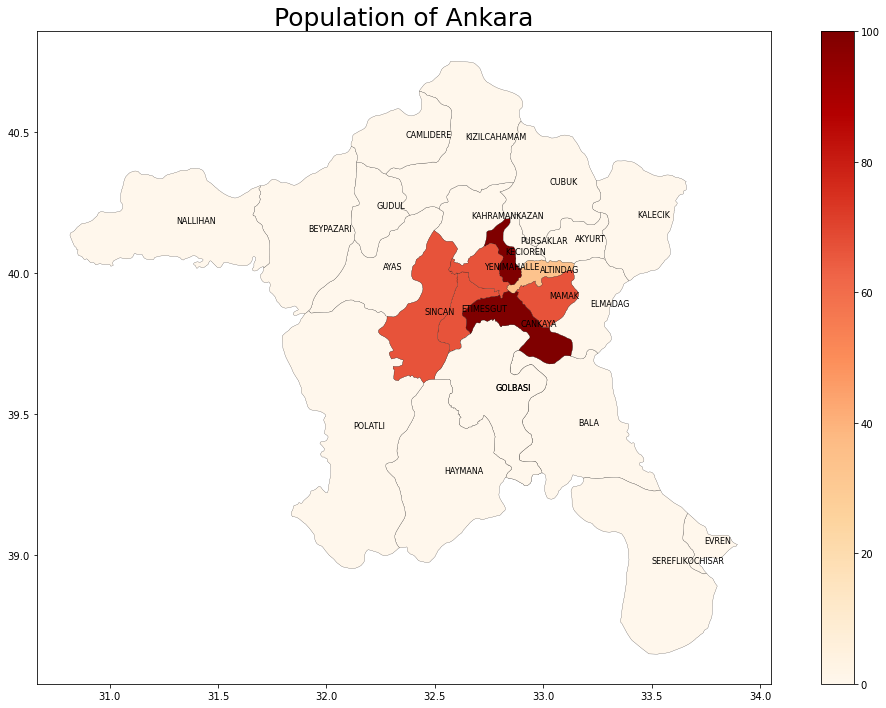

In [227]:
ankara = merged.query('adm1_tr == "ANKARA"') #query for spliting the data

variable = 'POP' #main variable for the comparision
# set the range for the choropleth
vmin, vmax = 0, 100
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(18, 12))

#adding annotations
ankara.apply(lambda x: ax.annotate(text=x['adm2_en'], fontsize=8,xy=x.geometry.centroid.coords[0], ha='left'), axis=1);

# adding a title
ax.set_title('Population of Ankara', fontdict={'fontsize': '25', 'fontweight' : '3'})

# Creating colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='OrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm)

ankara.plot(column=variable, scheme='natural_breaks', linewidth=0.2, k=4, cmap='OrRd', ax=ax, edgecolor='k', legend=False)



<AxesSubplot:title={'center':'Population of İstanbul'}>

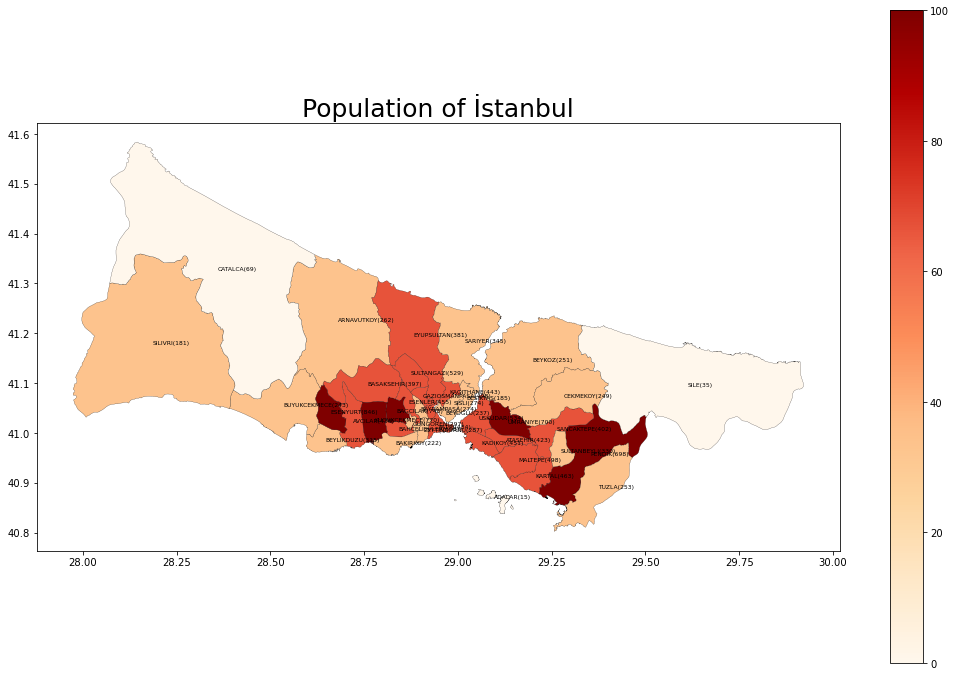

In [228]:
istanbul = merged.query('adm1_tr == "İSTANBUL"') #same type query

variable = 'POP'
# set the range for the choropleth
vmin, vmax = 0, 100
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(18, 12))

istanbul.apply(lambda x: ax.annotate(text=x['adm2_en'] + '('+str(round(x['POP']/1000))+')', fontsize=6, xy=x.geometry.centroid.coords[0], va='center', ha='left'), axis=1);

# adding title
ax.set_title('Population of İstanbul', fontdict={'fontsize': '25', 'fontweight' : '3'})
# create an annotation for the data source

# Creating colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='OrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm)

istanbul.plot(column=variable, scheme='natural_breaks', linewidth=0.2, k=4, cmap='OrRd', ax=ax, edgecolor='k', legend=False)



Text(0.5, 1.0, 'Population of Turkey')

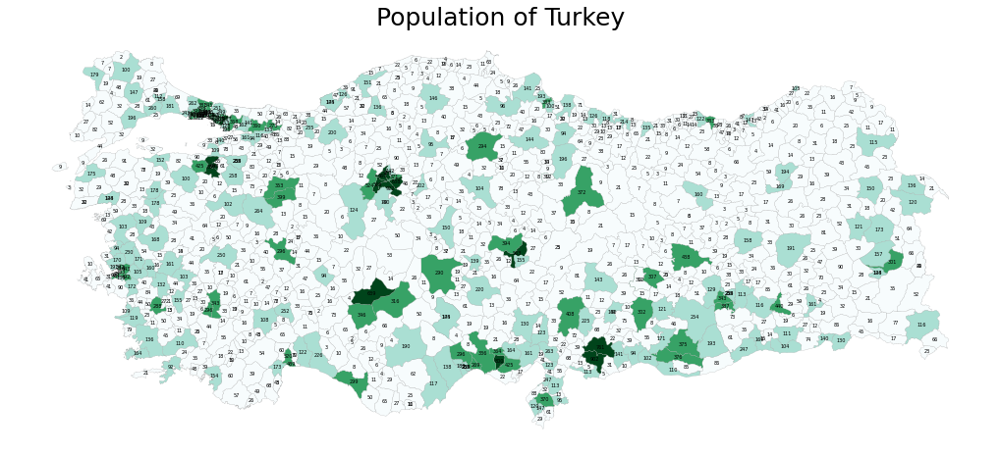

In [229]:
variable = 'POP' #POP-Temp
# set the range for the choropleth
vmin, vmax = 100, 1000
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(18, 12))

#adding different type of features
merged.plot(column=variable, scheme='natural_breaks', linewidth=0.2, k=4, cmap='BuGn', ax=ax, edgecolor='0.6', legend=False)
merged.apply(lambda x: ax.annotate(text=round(x['POP']/1000), fontsize=5, xy=x.geometry.centroid.coords[0], va='center', ha='center'), axis=1);

# removing the axis
ax.axis('off')
#merged.head()

# adding a title
ax.set_title('Population of Turkey', fontdict={'fontsize': '25', 'fontweight' : '3'})

In [230]:
# Creating colorbar as a legend
smAll = plt.cm.ScalarMappable(cmap='BuGn', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
smAll._A = []
# adding the colorbar to the figure
cbar = fig.colorbar(smAll)
#saving our map as .png file.
fig.savefig('map_export.png', dpi=300)

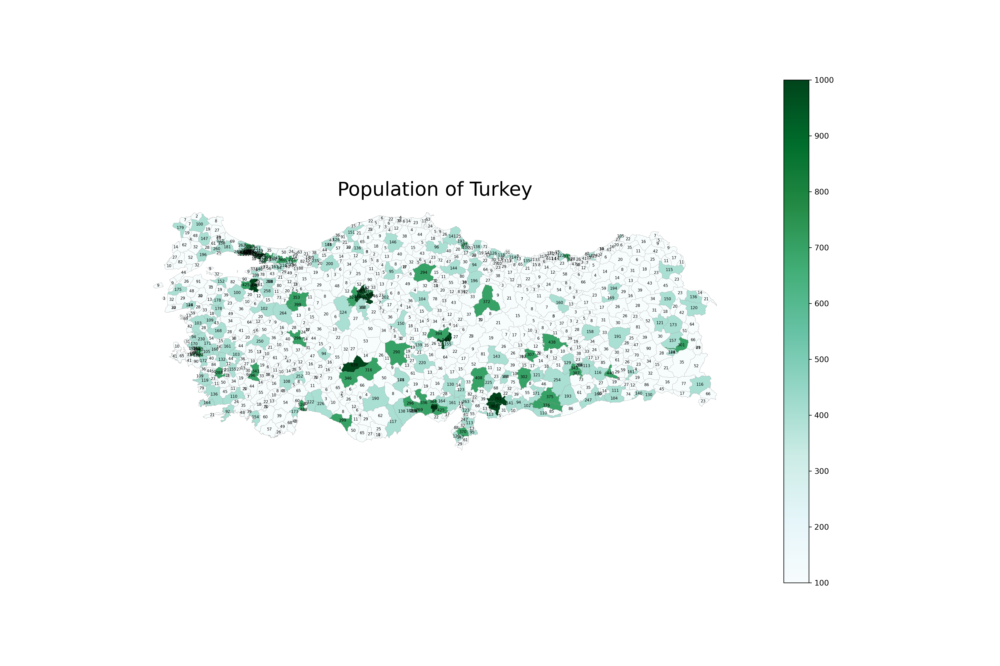

In [231]:
from IPython.display import Image 
pil_img = Image(filename='map_export.png')
display(pil_img) #show recent figure

<a href="https://www.linkedin.com/in/denizumutdereli/" target="_blank">@denizumutdereli</a>